<a href="https://colab.research.google.com/github/gargi510/Learner-Profiling-Job-Clustering-Scalar/blob/main/job_clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Learner Profiling & Job Clustering

## Problem Statement
Scaler is an online tech-versity offering intensive computer science and data science courses to professionals. As part of the analytics team, the goal is to analyze learner data to identify meaningful clusters based on job profile, company, and other career-related features. These clusters will help profile the best companies and positions for Scaler learners, enabling insights into career trends and patterns among graduates.

## Data Dictionary

- **Unnamed: 0** – Index of the dataset  
- **Email_hash** – Anonymized Personal Identifiable Information (PII)  
- **Company_hash** – Anonymized identifier for the learner's current employer  
- **orgyear** – Employment start year  
- **CTC** – Current CTC of the learner  
- **Job_position** – Learner’s job profile in the company  
- **CTC_updated_year** – Year in which CTC was updated (e.g., increments or promotions)  


## Solution Approach

Thee following structured approach was taken to analyze and extract actionable insights:

1. **Data Cleaning and Preprocessing**
   - Check the dataset structure and data types.
   - Identify and handle missing values appropriately.
   - Detect and remove duplicate records if present.
   - Ensure data consistency and correct formats for each feature.

2. **Exploratory Data Analysis (EDA)**
   - Perform univariate analysis to understand the distribution of individual features.
   - Identify outliers and apply clipping or transformations if necessary.
   - Conduct bivariate and multivariate analysis to explore relationships between features.

3. **Manual Clustering and Initial Insights**
   - Apply manual segmentation techniques to identify obvious patterns or groupings.
   - Document preliminary insights from the manual clustering.

4. **Unsupervised Clustering**
   - **Techniques**: Apply KMeans and Hierarchical Clustering to identify natural groupings.
   - **Sampling**: Due to dataset size, Hierarchical Clustering will be performed on a random sample of 10,000 records.
   - **Preprocessing for Clustering**:
     - Address multicollinearity using Variance Inflation Factor (VIF) if detected.
     - Reduce noise using DBSCAN to improve cluster quality.
   - **Clustering Tendency**: Assess the dataset's clusterability using Hopkins statistic.
   - **Dimensionality Reduction for Visualization**: Use PCA, t-SNE, and UMAP to visualize clusters in 2D space.

5. **KMeans Clustering**
   - Determine the optimal number of clusters using the Elbow method and Silhouette score.
   - Run the KMeans model and analyze clusters using aggregation statistics.
   - Visualize cluster separation in 2D using dimensionality reduction techniques.

6. **Hierarchical Clustering**
   - Use dendrograms and Silhouette scores to select the appropriate number of clusters.
   - Analyze and interpret clusters for business insights.
   - Visualize clusters using 2D projections.

7. **Insights and Recommendations**
   - Summarize insights from the full analysis, including structural checks, EDA, manual clustering, and both unsupervised techniques.
   - Provide actionable recommendations based on observed patterns and cluster characteristics.
   - Highlight potential business strategies or interventions informed by the clustering outcomes.

This structured approach ensures a comprehensive understanding of the dataset, robust clustering, and clear, actionable insights for decision-making.


# Import and Data Structure

## Imporing

In [2]:
#!pip install pyclustertend
#!pip install openTSNE
#!pip install umap

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import gaussian_kde

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from openTSNE import TSNE
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.cluster import DBSCAN
import umap

from statsmodels.stats.outliers_influence import variance_inflation_factor
from pyclustertend import hopkins

import re

In [4]:
url='https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/002/856/original/scaler_clustering.csv'

df = pd.read_csv(url)
df.head()

,Unnamed: 0,company_hash,email_hash,orgyear,ctc,job_position,ctc_updated_year
0,0,atrgxnnt xzaxv,6de0a4417d18ab14334c3f43397fc13b30c35149d70c05...,2016.0,1100000,Other,2020.0
1,1,qtrxvzwt xzegwgbb rxbxnta,b0aaf1ac138b53cb6e039ba2c3d6604a250d02d5145c10...,2018.0,449999,FullStack Engineer,2019.0
2,2,ojzwnvwnxw vx,4860c670bcd48fb96c02a4b0ae3608ae6fdd98176112e9...,2015.0,2000000,Backend Engineer,2020.0
3,3,ngpgutaxv,effdede7a2e7c2af664c8a31d9346385016128d66bbc58...,2017.0,700000,Backend Engineer,2019.0
4,4,qxen sqghu,6ff54e709262f55cb999a1c1db8436cb2055d8f79ab520...,2017.0,1400000,FullStack Engineer,2019.0


## Data structure

In [5]:
df.shape

(205843, 7)

In [6]:
df.columns

Index(['Unnamed: 0', 'company_hash', 'email_hash', 'orgyear', 'ctc',
       'job_position', 'ctc_updated_year'],
      dtype='object')

In [7]:
df.describe()

,Unnamed: 0,orgyear,ctc,ctc_updated_year
count,205843.000000,205757.000000,2.058430e+05,205843.000000
mean,103273.941786,2014.882750,2.271685e+06,2019.628231
std,59741.306484,63.571115,1.180091e+07,1.325104
min,0.000000,0.000000,2.000000e+00,2015.000000
25%,51518.500000,2013.000000,5.300000e+05,2019.000000
50%,103151.000000,2016.000000,9.500000e+05,2020.000000
75%,154992.500000,2018.000000,1.700000e+06,2021.000000
max,206922.000000,20165.000000,1.000150e+09,2021.000000


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205843 entries, 0 to 205842
Data columns (total 7 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        205843 non-null  int64  
 1   company_hash      205799 non-null  object 
 2   email_hash        205843 non-null  object 
 3   orgyear           205757 non-null  float64
 4   ctc               205843 non-null  int64  
 5   job_position      153279 non-null  object 
 6   ctc_updated_year  205843 non-null  float64
dtypes: float64(2), int64(2), object(3)
memory usage: 11.0+ MB


### Dataset Initial Observation

The dataset has 205,843 rows and 7 columns.  

- **`Unnamed: 0`**: High cardinality, not meaningful → **needs to be dropped**.  
- **`company_hash`**: Missing values → **needs treatment**; convert to `category` because it is an identifier with discrete values.  
- **`orgyear`**: Missing values → **needs treatment**; convert to `int` for numerical analysis.  
- **`job_position`**: Missing values (~25%) → **requires special handling**; convert to `category` because it represents discrete job roles.  
- **`ctc`**: Has outliers → **needs inspection and cleaning**; keep as `float/int` for numerical operations.  
- **`ctc_updated_year`**: Datatype should be `int` → useful for numerical computations and trend analysis.  


# Data Cleaning and Preprocessing

In [9]:
df.drop('Unnamed: 0',axis=1, inplace=True)
print(df.shape)

(205843, 6)


`Unnamed: 0` column has been dropped due to high cardinality as it will not provide meaningfull information to the analysis



### Missing Value Handling

In [10]:
#missing values
df.isna().sum()

,0
company_hash,44
email_hash,0
orgyear,86
ctc,0
job_position,52564
ctc_updated_year,0


- **`company_hash`**: 44 missing values, very few; can be easily handled.  
- **`orgyear`**: 86 missing values, small proportion; suitable for median imputation.  
- **`job_position`**: 52,564 missing values (~25% of data); requires special handling.  


In [11]:
df["company_hash"] = df["company_hash"].fillna("Unknown")
df["job_position"] = df["job_position"].fillna("Unknown")
df["orgyear"] = df["orgyear"].fillna(df["orgyear"].median())

df[["orgyear", "ctc_updated_year"]] = df[["orgyear", "ctc_updated_year"]].astype(int)

df.isna().sum()

,0
company_hash,0
email_hash,0
orgyear,0
ctc,0
job_position,0
ctc_updated_year,0


- **`orgyear`**: Missing values imputed with the **median** to preserve numerical consistency.  
- **`company_hash`**: Missing values filled with `"Unknown"` as a placeholder.  
- **Data Type Conversion**: Columns `orgyear` and `ctc_updated_year` converted from **float to integer** for numerical operations.  

After these steps, the dataset has **no missing values** and is ready for further analysis.

### Data Cleaning and Removing duplicates

In [12]:
for col in df.select_dtypes(include="object").columns:
    mask = df[col].str.contains(r'[^A-Za-z0-9 ]', na=False)
    if mask.any():
        print(f"\nColumn: {col}")
        print(df.loc[mask, [col]])


Column: job_position
       job_position
316      Co-founder
496      Co-founder
1060     Co-founder
2199     Co-founder
2418     Co-founder
...             ...
202770   Co-founder
202846   Co-founder
203925   Co-founder
203944   Co-founder
204996   Co-founder

[678 rows x 1 columns]


- The `job_position` column contains special characters in 678 rows (e.g., hyphens, punctuation).  
- These inconsistencies can affect grouping, duplicate detection, and clustering.

In [13]:
df["job_position"] = df["job_position"].str.replace(r'[^A-Za-z0-9 ]', '', regex=True)
df["job_position"] = df["job_position"].str.replace(r'\s+', ' ', regex=True).str.strip()


- Removed all special characters using regex: `r'[^A-Za-z0-9 ]'`.  
- Cleaned extra whitespace and leading/trailing spaces using regex: `r'\s+'` and `.str.strip()`.  

In [14]:
df = df.drop_duplicates().reset_index(drop=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205808 entries, 0 to 205807
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   company_hash      205808 non-null  object
 1   email_hash        205808 non-null  object
 2   orgyear           205808 non-null  int64 
 3   ctc               205808 non-null  int64 
 4   job_position      205808 non-null  object
 5   ctc_updated_year  205808 non-null  int64 
dtypes: int64(3), object(3)
memory usage: 9.4+ MB


- After cleaning `job_position` using regex, formatting inconsistencies are removed.  
- We can now safely drop duplicate rows to ensure each record is unique, preventing biased analysis and clustering.  
- Dataset rows decreased to 205,808 as 35 duplicate rows were removed.

In [15]:
def normalize_job(title):
    title = str(title).lower()
    title = re.sub(r'[^a-z0-9\s]', '', title)  # remove punctuation
    title = re.sub(r'\s+', ' ', title).strip()  # normalize spaces

    # Map 2-level roles
    if re.search(r"(sde\s*2|software\s*(development|developer|engineer)\s*2|software\s*(development|developer|engineer)\s*ii)", title):
        return "SDE2"

    # Map 1-level roles
    if re.search(r"(sde\s*1|software\s*(development|developer|engineer)\s*1|software\s*(development|developer|engineer)\s*i)", title):
        return "SDE1"

    return title.title()

df["job_position_normalized"] = df["job_position"].apply(normalize_job)

- All job titles were standardized to handle variations in formatting, punctuation, and spacing.  
- Common roles were mapped to unified categories, e.g., "SDE 1" and its variants → "SDE1", "SDE 2" and variants → "SDE2".  
- A new column `job_position_normalized` was created to store these normalized job titles, ensuring consistent grouping and analysis.


In [16]:
'''for col in df.select_dtypes(include='object').columns:
    df[col] = df[col].astype('category')

df.dtypes'''

"for col in df.select_dtypes(include='object').columns:\n    df[col] = df[col].astype('category')\n\ndf.dtypes"

All features with `object` datatype have been converted to **category** datatype.  
This ensures faster operations, reduced memory usage, and efficient handling of repeated values during EDA and aggregations.

# Univariate Analysis

In [17]:

try:
    from scipy.stats import gaussian_kde
    HAS_SCIPY = True
except Exception:
    HAS_SCIPY = False

cols = ["ctc", "orgyear", "ctc_updated_year"]

# Build titles in left-to-right, top-to-bottom order, per row
subplot_titles = []
for c in cols:
    subplot_titles += [f"{c} — Histogram/KDE", f"{c} — Boxplot"]

fig = make_subplots(
    rows=3, cols=2,
    subplot_titles=subplot_titles,
    horizontal_spacing=0.12, vertical_spacing=0.12
)

for i, col in enumerate(cols, start=1):
    data = df[col].dropna().astype(float).values

    # --- Left: Histogram (+ KDE) ---
    fig.add_trace(
        go.Histogram(
            x=data,
            nbinsx=60,
            histnorm="probability density",  # so KDE overlays on same y-scale
            name=f"{col} Histogram",
            showlegend=False
        ),
        row=i, col=1
    )

    # KDE (robust for very large n)
    if HAS_SCIPY and len(np.unique(data)) > 1:
        # subsample for speed if very large
        if data.size > 60000:
            rng = np.random.default_rng(42)
            sample = rng.choice(data, size=60000, replace=False)
        else:
            sample = data

        kde = gaussian_kde(sample)
        x_grid = np.linspace(data.min(), data.max(), 300)
        y_grid = kde.evaluate(x_grid)

        fig.add_trace(
            go.Scatter(
                x=x_grid, y=y_grid, mode="lines",
                name=f"{col} KDE",
                showlegend=False
            ),
            row=i, col=1
        )

    # --- Right: Boxplot (horizontal for readability) ---
    fig.add_trace(
        go.Box(
            x=data,
            name=f"{col} Box",
            boxpoints="outliers",
            showlegend=False,
            orientation="h"
        ),
        row=i, col=2
    )

    # Axis labels per row
    fig.update_xaxes(title_text=col, row=i, col=1)
    fig.update_yaxes(title_text="Density", row=i, col=1)
    fig.update_xaxes(title_text=col, row=i, col=2)

fig.update_layout(
    height=1200, width=1100,
    title="Distributions (Histogram+KDE) and Boxplots for ctc, orgyear, ctc_updated_year",
    bargap=0.03
)

fig.show()


#### Univariate Analysis of Numerical Variables

- **CTC (Compensation)**: Highly right-skewed with most salaries concentrated at lower values. Extreme outliers exist, including one as high as 1 billion and some unrealistically low values (< 1000/year). Typical salaries are within a reasonable range, while a few executives earn exceptionally high compensations. These extreme values need to be addressed for meaningful analysis.  

- **orgyear (Organizational Year/Start Year)**: Heavily right-skewed with most data clustered at plausible low-year values. Some entries (e.g., 20,000) are clear outliers and likely erroneous. A subset of 2–3 digit values also appear unrealistic. Cleaning and capping these outliers is necessary.  

- **ctc_updated_year**: Concentrated in recent years (2018–2021), slightly left-skewed with median around 2019. Peaks observed in 2019 and 2021. One lower-end outlier around 2015 appears reasonable. Overall, this variable is consistent and requires minimal cleaning.


In [18]:
def get_top(series, name):
    counts = series.value_counts().reset_index()
    counts.columns = [name, "count"]
    return counts.nlargest(5, "count").sort_values("count", ascending=True)

top_comp = get_top(df["company_hash"], "company_hash")
top_jobs = get_top(df["job_position"], "job_position")
top_emp = get_top(df["email_hash"], "email_hash")

fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=[
        "Top 5 Companies",
        "Top 5 Job Positions",
        "Top 5 Employees"
    ]
)

# Companies
fig.add_trace(go.Bar(y=top_comp["company_hash"], x=top_comp["count"], orientation="h", marker_color="green"), row=1, col=1)

# Jobs
fig.add_trace(go.Bar(y=top_jobs["job_position"], x=top_jobs["count"], orientation="h", marker_color="royalblue"), row=2, col=1)

# Employees
fig.add_trace(go.Bar(y=top_emp["email_hash"], x=top_emp["count"],orientation="h", marker_color="orange"), row=3, col=1)


fig.update_layout(
    height=900, width=1000,
    title_text="Top 5 Companies, Jobs, Employees by Count",
    showlegend=False
)


fig.update_xaxes(tickangle=60, row=3, col=1)

fig.show()


#### Top Entries Analysis
- **Companies**: The dataset is dominated by a few companies, with the top two appearing 8,337 and 5,381 times, indicating a concentration of learners employed at these organizations.  

- **Job Positions**: A large proportion of records (52,548) have the `Unknown` job position, reflecting missing or unreported roles. Among known roles, `Backend Engineer` (43,546) and `Full Stack Engineer` (24,710) are the most common, highlighting key technical positions in the dataset.  

- **Employees**: Some learners appear multiple times due to repeated records or updates. The top two `email_hash` entries appear 10 and 9 times respectively, consistent with the presence of multiple records per individual.  

- **Handling Multiple Records**: We need to merge multiple entries per learner before clustering; otherwise, results will be biased towards learners with more records, favoring the majority.


##Outlier Handling

In [19]:
df["ctc"] = df["ctc"] / 100000
df = df[(df["orgyear"] >= 1990) & (df["orgyear"] <= 2025)]
df = df[(df["ctc"] >= 0.1) & (df["ctc"] <= 260)]
df.reset_index(drop=True, inplace=True)

- **CTC**: Scaled to lakhs and restricted to the range 0.1–260 to remove extreme low and high outliers.  
- **orgyear**: Filtered to the range 1990–2025 to exclude unrealistic organizational year values.

In [20]:
try:
    from scipy.stats import gaussian_kde
    HAS_SCIPY = True
except Exception:
    HAS_SCIPY = False

cols = ["ctc", "orgyear", "ctc_updated_year"]

# Build titles in left-to-right, top-to-bottom order, per row
subplot_titles = []
for c in cols:
    subplot_titles += [f"{c} — Histogram/KDE", f"{c} — Boxplot"]

fig = make_subplots(
    rows=3, cols=2,
    subplot_titles=subplot_titles,
    horizontal_spacing=0.12, vertical_spacing=0.12
)

for i, col in enumerate(cols, start=1):
    data = df[col].dropna().astype(float).values

    # --- Left: Histogram (+ KDE) ---
    fig.add_trace(
        go.Histogram(
            x=data,
            nbinsx=60,
            histnorm="probability density",  # so KDE overlays on same y-scale
            name=f"{col} Histogram",
            showlegend=False
        ),
        row=i, col=1
    )

    # KDE (robust for very large n)
    if HAS_SCIPY and len(np.unique(data)) > 1:
        # subsample for speed if very large
        if data.size > 60000:
            rng = np.random.default_rng(42)
            sample = rng.choice(data, size=60000, replace=False)
        else:
            sample = data

        kde = gaussian_kde(sample)
        x_grid = np.linspace(data.min(), data.max(), 300)
        y_grid = kde.evaluate(x_grid)

        fig.add_trace(
            go.Scatter(
                x=x_grid, y=y_grid, mode="lines",
                name=f"{col} KDE",
                showlegend=False
            ),
            row=i, col=1
        )

    # --- Right: Boxplot (horizontal for readability) ---
    fig.add_trace(
        go.Box(
            x=data,
            name=f"{col} Box",
            boxpoints="outliers",
            showlegend=False,
            orientation="h"
        ),
        row=i, col=2
    )

    # Axis labels per row
    fig.update_xaxes(title_text=col, row=i, col=1)
    fig.update_yaxes(title_text="Density", row=i, col=1)
    fig.update_xaxes(title_text=col, row=i, col=2)

fig.update_layout(
    height=1200, width=1100,
    title="Distributions (Histogram+KDE) and Boxplots for ctc, orgyear, ctc_updated_year",
    bargap=0.03
)

fig.show()


- After outlier handling, both **CTC** and **orgyear** show improved distributions, with extreme values removed and the data more representative for analysis and clustering.


#Feature Engineering

In [21]:
CURRENT_YEAR = 2025

df["years_of_experience"] = CURRENT_YEAR - df["orgyear"]

### Creating Years of Experience (YOE)
- Added a new variable `years_of_experience` assuming employees are still with the company in 2025.  
- This provides an additional feature to capture the tenure of each learner for analysis and clustering.


In [22]:
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=["Years of Experience - Histogram", "Years of Experience - Boxplot"],
    horizontal_spacing=0.2
)

# Histogram
hist = px.histogram(df, x="years_of_experience", nbins=40)
for trace in hist.data:
    fig.add_trace(trace, row=1, col=1)

# Boxplot
box = px.box(df, y="years_of_experience")
for trace in box.data:
    fig.add_trace(trace, row=1, col=2)

fig.update_layout(
    height=500, width=1000,
    title="Distribution of Years of Experience"
)
fig.show()

- The distribution is **right-skewed**, with most learners having fewer years of experience.  
- The histogram shows a peak around **5–7 years**, with a **median of ~9 years**.  
- While the majority of learners have **less than 20 years of experience**, the boxplot reveals a **long tail** of outliers extending up to **35 years**, representing highly experienced individuals.  
- Overall, the feature captures typical employee tenure, with a few exceptional cases influencing the upper range.

# Manual Clustering

In [23]:
ctc_summary = df.groupby(
    ["company_hash", "job_position", "years_of_experience"],
    observed=False
)["ctc"].agg(["mean", "median", "max", "min", "count"]).reset_index()

ctc_summary.head()

,company_hash,job_position,years_of_experience,mean,median,max,min,count
0,0,Other,5,1.0,1.0,1.0,1.0,1
1,0,Unknown,5,1.0,1.0,1.0,1.0,1
2,0000,Other,8,3.0,3.0,3.0,3.0,1
3,01 ojztqsj,Android Engineer,9,2.7,2.7,2.7,2.7,1
4,01 ojztqsj,Frontend Engineer,14,8.3,8.3,8.3,8.3,1


- Grouped the data by `company_hash`, `job_position`, and `years_of_experience` to summarize compensation patterns.  
- Calculated key statistics (`mean`, `median`, `max`, `min`, `count`) of CTC within each group, creating representative profiles for clusters before applying formal clustering algorithms.


In [24]:
df=df.merge(ctc_summary, on=["company_hash","job_position","years_of_experience"], how ='left')
df.head()

,company_hash,email_hash,orgyear,ctc,job_position,ctc_updated_year,job_position_normalized,years_of_experience,mean,median,max,min,count
0,atrgxnnt xzaxv,6de0a4417d18ab14334c3f43397fc13b30c35149d70c05...,2016,11.00000,Other,2020,Other,9,11.000000,11.0,11.0,11.00000,1
1,qtrxvzwt xzegwgbb rxbxnta,b0aaf1ac138b53cb6e039ba2c3d6604a250d02d5145c10...,2018,4.49999,FullStack Engineer,2019,Fullstack Engineer,7,7.742856,7.5,12.0,4.49999,7
2,ojzwnvwnxw vx,4860c670bcd48fb96c02a4b0ae3608ae6fdd98176112e9...,2015,20.00000,Backend Engineer,2020,Backend Engineer,10,20.000000,20.0,20.0,20.00000,1
3,ngpgutaxv,effdede7a2e7c2af664c8a31d9346385016128d66bbc58...,2017,7.00000,Backend Engineer,2019,Backend Engineer,8,11.585714,12.0,17.5,7.00000,7
4,qxen sqghu,6ff54e709262f55cb999a1c1db8436cb2055d8f79ab520...,2017,14.00000,FullStack Engineer,2019,Fullstack Engineer,8,14.000000,14.0,14.0,14.00000,1


- Merged the aggregated compensation statistics back into the main dataset, aligning each record with its corresponding `mean`, `median`, `max`, `min`, and `count` of CTC based on company, job, and experience.  
- This enriches the dataset with summarized cluster-level information, facilitating analysis and subsequent clustering.


##Flag Creation

In [25]:
df["designation_flag"] = df.apply(lambda row: 1 if row["ctc"] > row["mean"] else 2 if row["ctc"] == row["mean"] else 3, axis=1)

class_summary = df.groupby(["company_hash", "job_position"])["ctc"].agg(['mean']).reset_index()
df = df.merge(class_summary, on=["company_hash", "job_position"], how="left", suffixes=("", "_class"))
df["class_flag"] = df.apply(lambda row: 1 if row["ctc"] > row["mean_class"] else 2 if row["ctc"] == row["mean_class"] else 3, axis=1)

tier_summary = df.groupby("company_hash")["ctc"].agg(['mean']).reset_index()
df = df.merge(tier_summary, on="company_hash", how="left", suffixes=("", "_tier"))
df["tier_flag"] = df.apply(lambda row: 1 if row["ctc"] > row["mean_tier"] else 2 if row["ctc"] == row["mean_tier"] else 3, axis=1)


df.drop(columns=["mean_class","mean_tier"], inplace=True)

df.head()

,company_hash,email_hash,orgyear,ctc,job_position,ctc_updated_year,job_position_normalized,years_of_experience,mean,median,max,min,count,designation_flag,class_flag,tier_flag
0,atrgxnnt xzaxv,6de0a4417d18ab14334c3f43397fc13b30c35149d70c05...,2016,11.00000,Other,2020,Other,9,11.000000,11.0,11.0,11.00000,1,2,1,3
1,qtrxvzwt xzegwgbb rxbxnta,b0aaf1ac138b53cb6e039ba2c3d6604a250d02d5145c10...,2018,4.49999,FullStack Engineer,2019,Fullstack Engineer,7,7.742856,7.5,12.0,4.49999,7,3,3,3
2,ojzwnvwnxw vx,4860c670bcd48fb96c02a4b0ae3608ae6fdd98176112e9...,2015,20.00000,Backend Engineer,2020,Backend Engineer,10,20.000000,20.0,20.0,20.00000,1,2,2,2
3,ngpgutaxv,effdede7a2e7c2af664c8a31d9346385016128d66bbc58...,2017,7.00000,Backend Engineer,2019,Backend Engineer,8,11.585714,12.0,17.5,7.00000,7,3,3,3
4,qxen sqghu,6ff54e709262f55cb999a1c1db8436cb2055d8f79ab520...,2017,14.00000,FullStack Engineer,2019,Fullstack Engineer,8,14.000000,14.0,14.0,14.00000,1,2,1,1


### Flags

- **Designation Flag**: Indicates whether an employee’s CTC is above (1), equal to (2), or below (3) the average for their specific role and experience, highlighting individual performance relative to peers.  
- **Class Flag**: Reflects whether an employee’s CTC is above (1), equal to (2), or below (3) the company-wide average for their role, providing insight into role-level compensation standing.  
- **Tier Flag**: Shows whether an employee’s CTC is above (1), equal to (2), or below (3) the overall company average, capturing their position within the organizational pay structure.


In [26]:
df.describe()

,orgyear,ctc,ctc_updated_year,years_of_experience,mean,median,max,min,count,designation_flag,class_flag,tier_flag
count,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000,203237.000000
mean,2015.122040,13.360295,2019.628326,9.877960,13.360295,12.725691,26.006176,9.271826,27.690091,2.088099,2.155257,2.210779
std,4.195824,14.324763,1.328357,4.195824,12.349141,12.300190,31.507900,11.976275,88.275925,0.730846,0.839261,0.891777
min,1990.000000,0.100000,2015.000000,0.000000,0.100000,0.100000,0.100000,0.100000,1.000000,1.000000,1.000000,1.000000
25%,2013.000000,5.300000,2019.000000,7.000000,6.000000,5.500000,8.100000,2.800000,1.000000,2.000000,1.000000,1.000000
50%,2016.000000,9.400000,2020.000000,9.000000,10.000000,9.425000,15.000000,6.000000,2.000000,2.000000,2.000000,3.000000
75%,2018.000000,16.500000,2021.000000,12.000000,16.646087,16.000000,30.000000,12.000000,11.000000,3.000000,3.000000,3.000000
max,2025.000000,260.000000,2021.000000,35.000000,260.000000,260.000000,260.000000,260.000000,919.000000,3.000000,3.000000,3.000000


### Descriptive Statistics Observations – Flags

- **Designation Flag**: Mean ~2.09, median = 2, min = 1, max = 3. This shows that most employees fall into the middle designation tier, with relatively fewer in the top (3) or bottom (1) tiers.  

- **Class Flag**: Mean ~2.16, median = 2, min = 1, max = 3. Similar to designation, the majority of learners are around the middle class, with top performers (1) being a smaller segment.  

- **Tier Flag**: Mean ~2.21, median = 2, min = 1, max = 3. Most employees belong to mid-tier companies, with fewer in tier-1 (top) and tier-3 (bottom) companies.  

**Observation for Manual Clustering**:  
The flags are roughly balanced but slightly skewed toward middle tiers. This allows us to define clusters manually by combining **tier_flag, class_flag, and designation_flag** with **CTC** and **years_of_experience**:

- **Cluster 1 – High Value / Top Tier**: Employees in **tier_flag = 1**, **class_flag = 1**, high CTC, and substantial experience.  
- **Cluster 2 – Mid Value / Mid Tier**: Employees with **tier_flag ≈ 2**, **class_flag ≈ 2**, moderate CTC, median experience.  
- **Cluster 3 – Low Value / Entry Tier**: Employees with **tier_flag = 3**, **class_flag = 3**, low CTC, less experience.  

---

### Business Insights – Manual Clustering

- **High-Value Talent (Cluster 1)**: Concentrated in tier-1 companies, these employees command high compensation and have significant experience.
Focus retention, mentorship, and leadership programs here.  

- **Mid-Level Employees (Cluster 2)**: Represent the largest portion of the workforce.
Implement targeted learning programs and compensation alignment to accelerate growth and increase satisfaction.  

- **Entry-Level / Low-Value Employees (Cluster 3)**: Limited experience and lower compensation.
Use cluster insights to guide onboarding, training, and career progression to move them toward higher clusters.  

- **Overall Strategy**: Using **mean and median values of flags**, we can ensure clusters are meaningful and actionable, providing a foundation for **career pathing, upskilling, and strategic hiring** initiatives.


# Bivariate and Multivariate EDA

##Bivariate

### CTC of Employees, Companies, Job Position Across Top and Bottom Tier 1 Companies

In [27]:
top_employees_df = df[df["tier_flag"] == 1].nlargest(10, "ctc")
top_companies_df = df[df["tier_flag"] == 1].groupby("company_hash", as_index=False)["ctc"].mean().nlargest(10, "ctc")
top_jobs_df = df[df["designation_flag"] == 1].groupby("job_position_normalized", as_index=False)["ctc"].mean().nlargest(10, "ctc")

bottom_employees_df = df[df["tier_flag"] == 1].nsmallest(10, "ctc")
bottom_companies_df = df[df["tier_flag"] == 1].groupby("company_hash", as_index=False)["ctc"].mean().nsmallest(10, "ctc")
bottom_jobs_df = df[df["designation_flag"] == 1].groupby("job_position_normalized", as_index=False)["ctc"].mean().nsmallest(10, "ctc")

fig = make_subplots(
    rows=3, cols=2,
    subplot_titles=[
        "Top 10 Employees by CTC", "Bottom 10 Employees by CTC",
        "Top 10 Companies by Avg CTC", "Bottom 10 Companies by Avg CTC",
        "Top 10 Job Positions by Avg CTC", "Bottom 10 Job Positions by Avg CTC"
    ],
    horizontal_spacing=0.6,
    vertical_spacing=0.15
)

fig.add_trace(go.Bar(x=top_employees_df["ctc"], y=top_employees_df["email_hash"], orientation="h", marker_color="lightgreen", showlegend=False), row=1, col=1)
fig.add_trace(go.Bar(x=bottom_employees_df["ctc"], y=bottom_employees_df["email_hash"], orientation="h", marker_color="red", showlegend=False), row=1, col=2)

fig.add_trace(go.Bar(x=top_companies_df["ctc"], y=top_companies_df["company_hash"], orientation="h", marker_color="lightgreen", showlegend=False), row=2, col=1)
fig.add_trace(go.Bar(x=bottom_companies_df["ctc"], y=bottom_companies_df["company_hash"], orientation="h", marker_color="red", showlegend=False), row=2, col=2)  # light orange as hex

fig.add_trace(go.Bar(x=top_jobs_df["ctc"], y=top_jobs_df["job_position_normalized"], orientation="h", marker_color="lightgreen", showlegend=False), row=3, col=1)
fig.add_trace(go.Bar(x=bottom_jobs_df["ctc"], y=bottom_jobs_df["job_position_normalized"], orientation="h", marker_color="red", showlegend=False), row=3, col=2)

fig.update_layout(
    height=1200, width=1400,
    title_text="Top & Bottom 10 Employees, Companies, and Job Positions by CTC"
)

# Reverse y-axis for horizontal bars
for r in [1,2,3]:
    for c in [1,2]:
        fig.update_yaxes(autorange="reversed", row=r, col=c)

fig.show()


###Observation

The charts compare **top 10** (green) and **bottom 10** (red) across employees, companies, and job positions within **Tier 1 companies**.

#### Employees  
- **Top 10 employees** earn more than **₹2.4 Cr annually**  
- **Bottom 10 employees** earn less than **₹40,000 annually**  
This highlights the huge disparity in **individual earnings**.  

#### Companies  
- **Top 10 companies** offer **average packages of about ₹2 Cr**  
- **Bottom 10 companies** average **below ₹48,000**, likely **internship providers**  
This shows the contrast between **elite Tier 1 companies** and those hiring for **low-cost roles** or maybe internships.  

#### Job Positions  
- **Highest paying roles** include **Engineer (₹44 Lakh)**, **SDE2 (₹40 Lakh)**, and **Backend Architect (₹38.4 Lakh)**  
- **Lowest paying roles** include **Assistant System Engineering Trainee (₹3.4 Lakh)** and **Assistant System Engineer (₹4 Lakh)**  
This reflects the impact of **career progression** on **compensation**, even within **Tier 1 organizations**.   


## CTC of Data Science Employees Across Top and Bottom Tier Companies
---



In [28]:
# Top 10 Data Science employees (Tier 1, Class 1)
top10_ds = df[
    (df["tier_flag"] == 1) &
    (df["class_flag"] == 1) &
    (df["job_position_normalized"].str.contains("Data Scie", case=False, na=False))
].nlargest(10, "ctc").sort_values("ctc", ascending=False)

# Bottom 10 Data Science employees (Tier 3, Class 3)
bottom10_ds = df[
    (df["tier_flag"] == 3) &
    (df["class_flag"] == 3) &
    (df["job_position_normalized"].str.contains("Data Scie", case=False, na=False))
].nsmallest(10, "ctc").sort_values("ctc", ascending=True)

# Create subplots 2 rows × 1 column
fig = make_subplots(
    rows=2, cols=1,
    subplot_titles=[
        "Top 10 Data Science Employees (Tier 1, Class 1)",
        "Bottom 10 Data Science Employees (Tier 3, Class 3)"
    ],
    vertical_spacing=0.25
)

# Row 1: Top 10
fig.add_trace(
    go.Bar(
        y=top10_ds["email_hash"],
        x=top10_ds["ctc"],
        orientation="h",
        marker_color="lightgreen"
    ),
    row=1, col=1
)

# Row 2: Bottom 10
fig.add_trace(
    go.Bar(
        y=bottom10_ds["email_hash"],
        x=bottom10_ds["ctc"],
        orientation="h",
        marker_color="red"
    ),
    row=2, col=1
)

# Layout
fig.update_layout(
    height=900, width=1200,
    title_text="Top and Bottom 10 Data Science Employees Across All Companies",
    showlegend=False
)

# Reverse y-axis so highest CTC is on top
fig.update_yaxes(autorange="reversed", row=1, col=1)
fig.update_yaxes(autorange="reversed", row=2, col=1)

fig.show()


### Observation

- The graph compares **Data Science employees** in **Tier 1 (top)** and **Tier 3 (bottom)** organizations basis CTC
- **Green bars** show the **top 10 employees in Class 1**, earning above their peers, with annual CTC exceeding **₹1.2 Cr**.  
- **Red bars** show the **bottom 10 employees in Class 3**, earning below their peers, with annual CTC below **₹35,000**, and some as low as **₹10,000**.  
- This visualization highlights the **significant compensation disparity** both **within** and **across top and bottom tier companies** for Data Science roles.



## Top 10 Data Science Employees by CTC (Tier 1, 5–7 Years Experience)

In [29]:
top10_ds = df[
    (df["tier_flag"] == 1) &
    (df["class_flag"] == 1) &
    (df["job_position_normalized"].str.contains("Data Scie", case=False, na=False)) &
    (df["years_of_experience"].isin([5, 6, 7]))
].nlargest(10, "ctc").sort_values("ctc", ascending=False)

# Create horizontal bar chart
fig = go.Figure()

fig.add_trace(
    go.Bar(
        y=top10_ds["email_hash"],
        x=top10_ds["ctc"],
        orientation="h",
        marker_color="lightgreen"
    )
)

# Layout
fig.update_layout(
    title="Top 10 Data Science Employees (Tier 1, Class 1, 5–7 years experience)",
    xaxis_title="CTC",
    yaxis_title="Employee",
    height=600,
    width=900
)

# Reverse y-axis so highest CTC is on top
fig.update_yaxes(autorange="reversed")

fig.show()

###Observation
- Focuses on **Tier 1 companies** and employees in the **Data Science role** who are earning **more than their peers** (Class 1).  
- Includes employees with **5–7 years of work experience**, highlighting mid-level talent performing above average.  
- Annual CTC ranges from **₹54 Lakh to ₹1.2 Cr**, demonstrating strong compensation for top performers within this experience bracket.

## CTC vs Years of Experience

In [75]:
fig = px.scatter(df, x='years_of_experience', y='ctc', title='CTC vs Years of Experience')
fig.show()

The data suggests that **CTC generally increases with experience** up to a certain point (around **10–15 years**) before **plateauing** and potentially **decreasing** for those with more than **20 years of experience**.

## Heatmap

In [30]:
final_df= df[['ctc', 'years_of_experience','designation_flag', 'class_flag', 'tier_flag']]
corr = final_df.corr()

fig = px.imshow(
    corr,
    text_auto=True,
     color_continuous_scale="Reds",
    zmin=0, zmax=1,
    title="Correlation Heatmap of Features",
    aspect="auto"
)
fig.show()


### Observation

- Conducted a **heatmap analysis** on *CTC, Years of Experience, Designation Flag, Class Flag,* and *Tier Flag*.  
- Observed correlations:  
  - **Class Flag vs. Tier Flag** → 0.72 (high correlation)  
  - **Class Flag vs. Designation Flag** → 0.55 (moderate correlation)  
  - **Tier Flag vs. Designation Flag** → 0.46 (moderate correlation)  
- These results indicate **visible multicollinearity**, which can distort distance-based clustering outcomes.  
- To address clustering sensitivities:  
  - **Outliers have been clipped** to reduce distortion.  
  - **Multicollinearity check** will be performed (by using VIF) before final clustering.  
  - **DBSCAN** will be used, to detect clusters and noise

Correlated variables and outliers can bias clustering results; we have mitigated outliers and will validate multicollinearity, with DBSCAN as a backup for robustness.  


# Unsupervised Clustering

## Scaling and Multicollinearity Check using VIF  


In [31]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 203237 entries, 0 to 203236
Data columns (total 5 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ctc                  203237 non-null  float64
 1   years_of_experience  203237 non-null  int64  
 2   designation_flag     203237 non-null  int64  
 3   class_flag           203237 non-null  int64  
 4   tier_flag            203237 non-null  int64  
dtypes: float64(1), int64(4)
memory usage: 7.8 MB


In [32]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(final_df)

vif_data = pd.DataFrame()
vif_data["Feature"] = final_df.columns
vif_data["VIF"] = [variance_inflation_factor(X_scaled, i) for i in range(X_scaled.shape[1])]

print(vif_data)

               Feature       VIF
0                  ctc  1.303643
1  years_of_experience  1.146878
2     designation_flag  1.481037
3           class_flag  2.425870
4            tier_flag  2.318614


#### Observation

- **Scaling applied:** StandardScaler was used before VIF calculation to normalize the wide range of values (e.g., CTC vs. categorical flags).  
- **Result:** All features have **VIF < 2.5**, which indicates:  
  - Negligible multicollinearity.  
  - No variable is strongly dependent on another.  
  - All features can be safely retained for clustering.  

Since VIF values are well below the common threshold of 5 (and even 2.5), the dataset does not suffer from multicollinearity, making it suitable for **K-Means** and **Hierarchical Clustering**.  


## Detecting Clustering Tendancy

We will be using following techniques to see if The dataset has a clustering tendancy

- **Hopkins Statistic**: Checks if the dataset has meaningful cluster structure.  
- **PCA (initial)**: Visualizes clusters in reduced dimensions.  
- **DBSCAN**: Detects and removes noise/outliers on a few principal components.  
- **PCA (final)**: Captures main variance directions on cleaned data.  
- **t-SNE**: Visualizes high-dimensional structures in 2D/3D for final cluster inspection.


### Using Hopkins Statistics

In [33]:
from pyclustertend import hopkins

H = hopkins(X_scaled, sampling_size=2000)
print("Hopkins Statistic:", H)


Hopkins Statistic: 0.0025378800876938484


 A value close to 0 indicates a **highly clusterable dataset**, meaning the data points are not uniformly random and are likely to form meaningful clusters.  
This confirms that applying clustering algorithms like **DBSCAN, K-Means, or Hierarchical Clustering** is appropriate.

###2D PCA Visualization

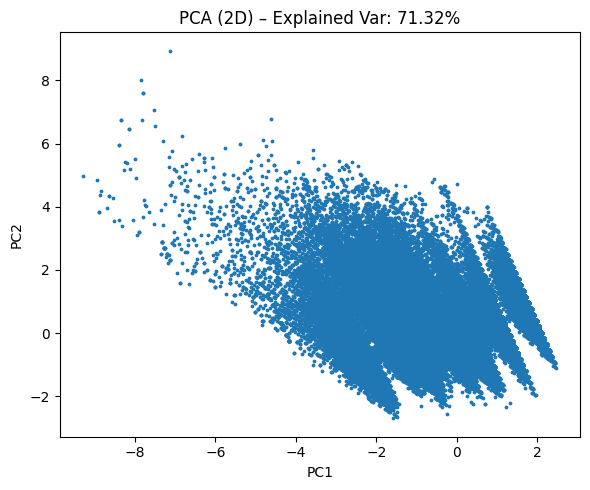

In [34]:
pca2 = PCA(n_components=2, random_state=42)
X_pca2 = pca2.fit_transform(X_scaled)
expl_var = pca2.explained_variance_ratio_.sum()

plt.figure(figsize=(6,5))
plt.scatter(X_pca2[:,0], X_pca2[:,1], s=3)
plt.title(f'PCA (2D) – Explained Var: {expl_var:.2%}')
plt.xlabel('PC1'); plt.ylabel('PC2')
plt.tight_layout()
plt.show()

Observation

- The PCA scatter plot shows **distinct clusters concentrated toward the bottom-right**, indicating the main variance in the data along that direction.  
- Several **outliers appear toward the top-left**, representing low-density points or unusual records that differ significantly from the main clusters.  
- **Explained variance**: PCA 2 captures 71%, PCA 3 captures 84%, and PCA 4 captures 94% of the total variance, showing that most of the dataset’s information is preserved in the first few components.

### Noise Removal using DBSCAN on PCA reduced Data

In [35]:
pca = PCA(n_components=4)
X_pca = pca.fit_transform(final_df)

In [36]:
dbscan = DBSCAN(eps=1.3, min_samples=5, n_jobs=-1)
#labels_db = dbscan.fit_predict(X_sample)
labels_db = dbscan.fit_predict(X_pca)


noise_idx = np.where(labels_db == -1)[0]
clean_df = final_df.drop(noise_idx).reset_index(drop=True)
print("Noise points removed:", len(noise_idx))

Noise points removed: 860


- Given the dataset has over 2 lakh records, running DBSCAN directly on the full data would be computationally intensive and may crash the system.  
- To address this, DBSCAN was applied on the **first 4 principal components**, which together explain 94% of the total variance, ensuring most information is retained.  
- An **eps value of 1.3** was chosen to remove a minimal number of outliers, preserving important data for clustering.  
- Using this approach, **860 outliers** were successfully identified and removed, resulting in a cleaner dataset for subsequent analysis.


In [37]:
scaler = StandardScaler()
X_scaled_clean = scaler.fit_transform(clean_df)

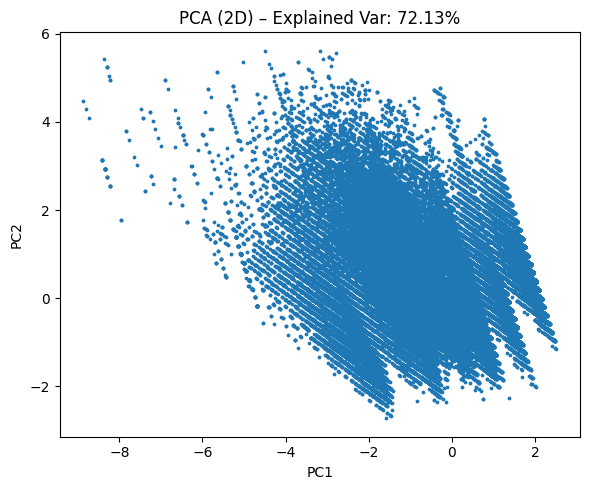

In [38]:
pca2 = PCA(n_components=2, random_state=42)
X_pca2 = pca2.fit_transform(X_scaled_clean)
expl_var = pca2.explained_variance_ratio_.sum()

plt.figure(figsize=(6,5))
plt.scatter(X_pca2[:,0], X_pca2[:,1], s=3)
plt.title(f'PCA (2D) – Explained Var: {expl_var:.2%}')
plt.xlabel('PC1'); plt.ylabel('PC2')
plt.tight_layout()
plt.show()

#### PCA 2D Visualization After Noise Removal

- PCA was applied on the scaled clean dataset obtained after removing noise with DBSCAN.  
- The new PCA plot shows that the data is **more centered**, and the number of noise points has been significantly reduced.  
- The first few principal components now explain **around 1% more variance** than before DBSCAN, indicating improved data structure and clarity for clustering analysis.

####T-SNE 2D after Noise Removal

/tmp/ipython-input-3613914444.py:20: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



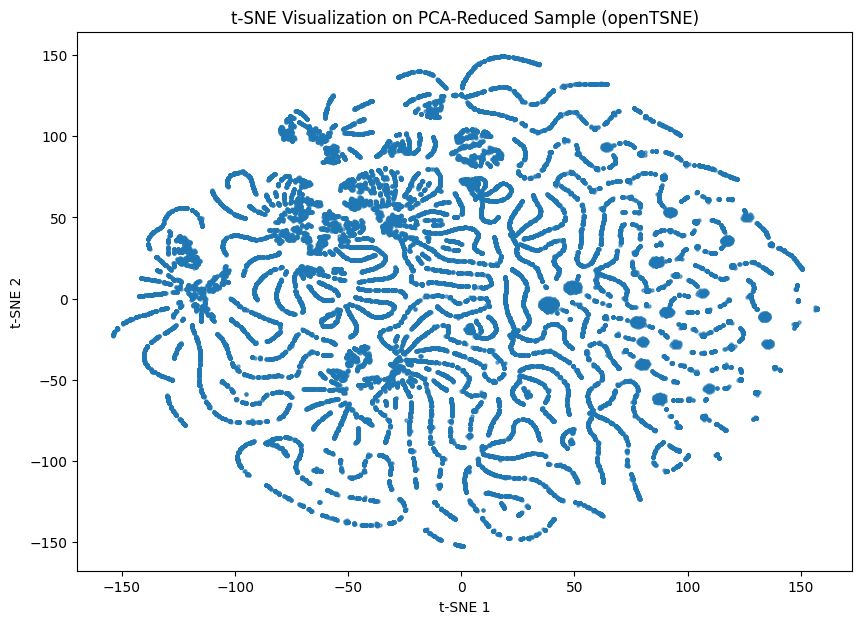

In [156]:
pca = PCA(n_components=4)
X_pca = pca.fit_transform(X_scaled_clean)

sample_size = 50000
idx = np.random.choice(X_pca.shape[0], size=sample_size, replace=False)
X_sample = X_pca[idx]

tsne = TSNE(
    n_components=2,
    perplexity=30,
    n_iter=1000,
    n_jobs=-1,
    random_state=42
)
X_tsne = tsne.fit(X_sample)

plt.figure(figsize=(10,7))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], s=5, alpha=0.6, cmap='tab10')
plt.title("t-SNE Visualization on PCA-Reduced Sample (openTSNE)")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.show()

- **PCA (30 → 2D)** shows one **dense cloud**, capturing variance but not revealing clear separations.  
- **t-SNE (after PCA)** forms a **maze-like, globular structure**, preserving local relationships.  
- Clusters are **not visually distinct**, so manual inspection is insufficient.  
- **Clustering algorithms (K-Means, Hierarchical, DBSCAN)** are needed for actionable segmentation.  

####UMAP 2D after Noise Removal

/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

/tmp/ipython-input-1668452833.py:13: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



<module 'matplotlib.pyplot' from '/usr/local/lib/python3.12/dist-packages/matplotlib/pyplot.py'>

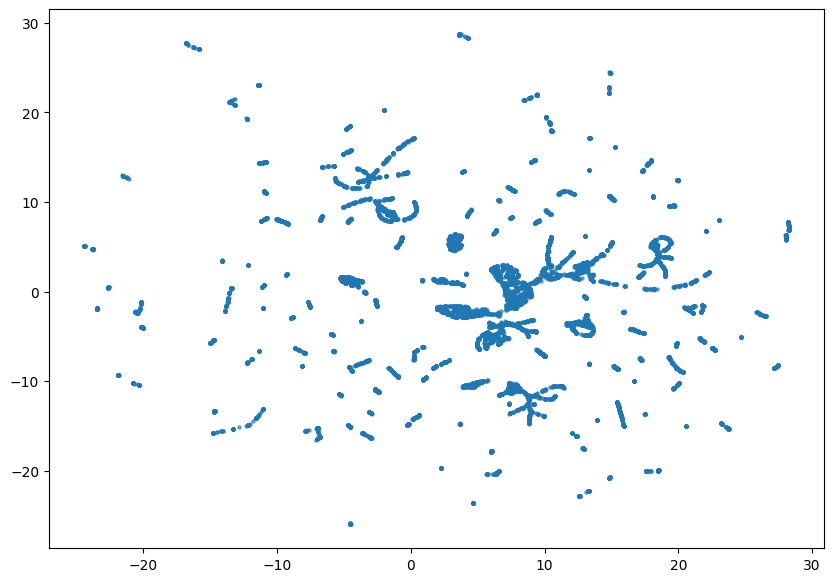

In [70]:
import umap.umap_ as umap

umap_model = umap.UMAP(
    n_neighbors=30,
    min_dist=0.1,
    n_components=2,
    metric="euclidean",
    random_state=42
)
X_umap = umap_model.fit_transform(X_pca)

plt.figure(figsize=(10,7))
plt.scatter(X_umap[:, 0], X_umap[:, 1], s=5, alpha=0.6, cmap='tab10')
plt

The UMAP plot shows a continuous, interconnected network of data points rather than well-separated clusters. Points are colored using a **colormap (cmap)**, which displays a smooth gradient instead of discrete labels. This indicates that cluster assignments are continuous, likely from hierarchical clustering, and that the dataset does not naturally form isolated groups. The UMAP visualization preserves both local and global structures, confirming the continuous, manifold-like nature of the data.

## K-Means

### Elbow Method

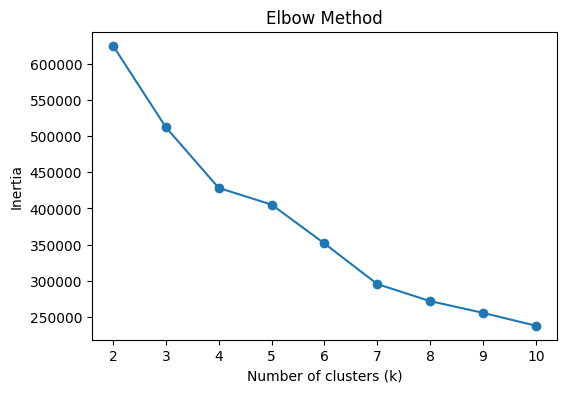

In [39]:
inertias = []
Ks = range(2, 11)  # check 2 to 10 clusters
for k in Ks:
    km = KMeans(n_clusters=k, init='k-means++', random_state=42)
    km.fit(X_scaled_clean)
    inertias.append(km.inertia_)

plt.figure(figsize=(6, 4))
plt.plot(Ks, inertias, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

#### Observation

- The **Elbow Method** was applied to determine the optimal number of clusters for K-Means clustering.  
- By plotting **Within-Cluster Sum of Squares (WCSS)** against different values of k, the point where the WCSS starts to level off indicates the optimal cluster count.  
- The plot shows a clear **elbow at k = 4**, suggesting that **4 clusters** capture the main structure in the data effectively.  


### Silhouette scores

In [76]:
for k in [2, 3, 4, 5,6]:
    km = KMeans(n_clusters=k,init='k-means++', random_state=42)
    labels = km.fit_predict(X_scaled_clean)
    sil_score = silhouette_score(X_scaled_clean, labels)
    print(f"Silhouette Score for k={k}: {sil_score:.3f}")

Silhouette Score for k=2: 0.378
Silhouette Score for k=3: 0.306
Silhouette Score for k=4: 0.328
Silhouette Score for k=5: 0.325
Silhouette Score for k=6: 0.335


Although the Silhouette Score was highest at **k = 2 (0.378)**, this solution was considered too coarse, as it collapses distinct subgroups into overly broad clusters. At **k = 4**, the Silhouette Score (0.328) represents a stable plateau observed across k = 4–6, indicating that additional clusters beyond four do not yield meaningful improvements in cohesion or separation.  

Moreover, the **elbow method clearly identified k = 4 as the optimal point**, and this choice is further supported by hierarchical dendrogram structures and t-SNE visualizations, which both suggest a natural four-way segmentation. While UMAP revealed overlapping structures, the four-cluster solution remains the most balanced outcome—providing sufficient granularity for actionable insights without over-fragmenting the data.  

**Final Choice:** The selection of **k = 4** achieves an effective balance between statistical validity, interpretability, and business applicability, enabling more meaningful profiling of learner and employee groups.


### Modeling K-Means Clustering

In [41]:
best_k = 4
kmeans = KMeans(n_clusters=best_k, n_init='auto', random_state=42)
clusters = kmeans.fit_predict(X_scaled_clean)

df_kmeans = clean_df.copy()
df_kmeans['cluster'] = clusters

### Cluster Profiling

In [42]:
print(kmeans.cluster_centers_)
print(df_kmeans['cluster'].value_counts())

[[-0.34963059 -0.17554062 -0.37600381  0.11788745  0.45003595]
 [-0.43324408 -0.3765082   1.2450364   1.00324947  0.83557083]
 [ 0.40065921 -0.19438299 -0.89414256 -1.15777554 -1.35472397]
 [ 1.41545522  1.72303881 -0.14525665 -0.71939996 -1.06159189]]
cluster
0    79061
1    56634
2    41492
3    25190
Name: count, dtype: int64


#### Observation

- **Cluster 0** contains **79,061 records**, representing the largest segment in the dataset.  
- **Cluster 1** has **56,634 records**, followed by **Cluster 2** with **41,492 records**, and **Cluster 3** with **25,190 records**, indicating progressively smaller groups.  
- The clusters appear well-separated based on the scaled features provided, reflecting distinct patterns in **CTC, years of experience, designation_flag, class_flag, and tier_flag**.  
- This distribution can help in identifying major learner segments, highlighting which groups dominate the dataset and which are niche.


In [43]:
cluster_summary = df_kmeans.groupby('cluster').agg({
    'ctc': ['mean', 'median', 'min', 'max'],
    'years_of_experience': ['mean', 'median', 'min', 'max'],
    'designation_flag': 'mean',
    'class_flag': 'mean',
    'tier_flag': 'mean',
}).reset_index()
print(cluster_summary)


  cluster        ctc                     years_of_experience                 \
                mean median   min    max                mean median min max   
0       0   8.621294    7.5  0.10   45.0            9.122121    9.0   0  25   
1       1   7.585209    6.0  0.10   38.0            8.291468    8.0   0  26   
2       2  17.950690   15.3  0.15   90.0            9.041647    9.0   1  17   
3       3  30.491084   26.0  0.10  250.0           16.989758   16.0   1  35   

  designation_flag class_flag tier_flag  
              mean       mean      mean  
0         1.814548   2.256979  2.615613  
1         2.999823   2.999612  2.959035  
2         1.435048   1.186879  1.007351  
3         1.983962   1.555022  1.268956  


#### Cluster Analysis

- **Cluster 0**:  
  - **CTC**: Mean 8.62 Lakh, Median 7.5 Lakh (range 0.10–45 Lakh)  
  - **Experience**: Mean ~9 years, median 9 years  
  - **Flags**: designation_flag ~1.81, class_flag ~2.26, tier_flag ~2.62  
  - **Profile**: Mid-level employees with moderate salaries and mid-tier positions.

- **Cluster 1**:  
  - **CTC**: Mean 7.59 Lakh, Median 6 Lakh (range 0.10–38 Lakh)  
  - **Experience**: Mean ~8.3 years, median 8 years  
  - **Flags**: designation_flag ~3, class_flag ~3, tier_flag ~2.96  
  - **Profile**: Junior employees or lower-paying roles; relatively less compensated compared to Cluster 0.

- **Cluster 2**:  
  - **CTC**: Mean 17.95 Lakh, Median 15.3 Lakh (range 0.15–90 Lakh)  
  - **Experience**: Mean ~9 years, median 9 years  
  - **Flags**: designation_flag ~1.43, class_flag ~1.18, tier_flag ~1  
  - **Profile**: High earners in mid-level roles; top-class employees in tier 1 companies.

- **Cluster 3**:  
  - **CTC**: Mean 30.49 Lakh, Median 26 Lakh (range 0.10–250 Lakh)  
  - **Experience**: Mean ~17 years, median 16 years  
  - **Flags**: designation_flag ~1.98, class_flag ~1.56, tier_flag ~1.27  
  - **Profile**: Senior employees with high compensation and significant experience; likely leadership or specialized roles.

> The clusters capture **distinct segments of employees** based on compensation, experience, and relative position within their companies. Cluster 2 and 3 represent **high-value employees**, while Cluster 0 and 1 include mid-level and junior roles.


### Visualizing Clusters in 2D

####PCA

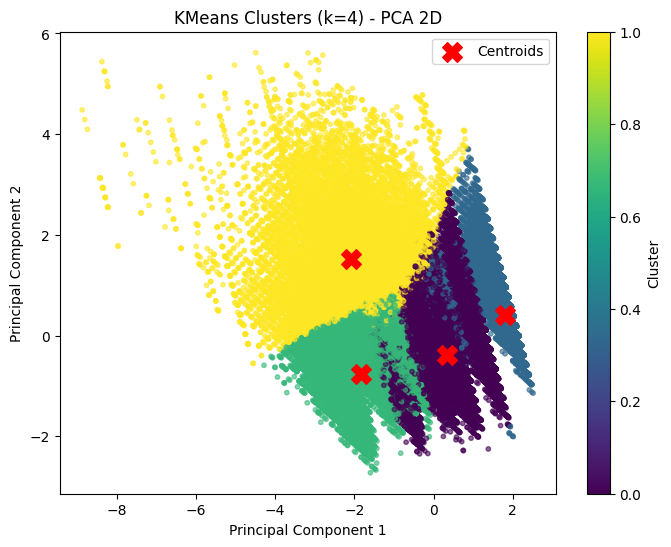

In [44]:
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_scaled_clean)

plt.figure(figsize=(8,6))
plt.scatter(
    X_pca[:,0], X_pca[:,1],
    c=clusters,
    cmap='viridis',
    s=10,
    alpha=0.6
)
centroids_pca = pca.transform(kmeans.cluster_centers_)
plt.scatter(
    centroids_pca[:,0], centroids_pca[:,1],
    c='red', s=200, marker='X', label='Centroids'
)
plt.title(f'KMeans Clusters (k={best_k}) - PCA 2D')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.colorbar(label='Cluster')
plt.show()

- **Cluster Shapes and Density**: Clusters have clear centroids but are not perfectly spherical and overlap, especially near the center. This reflects the continuous nature of the data.  
- **Cluster Assignments**: Points are assigned based on proximity to centroids, but boundaries are not distinct due to overlapping regions.  
- **Summary**: K-Means successfully partitions the data into 4 groups, but these clusters are algorithm-driven rather than naturally well-separated, consistent with observations from PCA and t-SNE visualizations.

####T-SNE

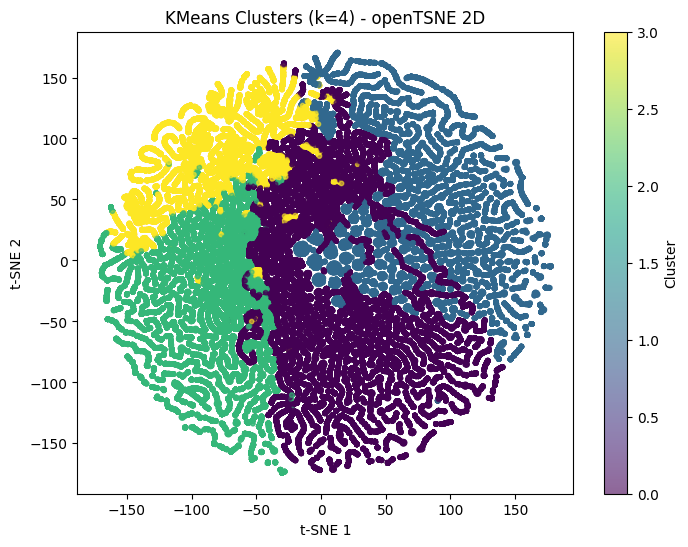

In [77]:
pca = PCA(n_components=X_scaled_clean.shape[1], random_state=42)
X_pca = pca.fit_transform(X_scaled_clean)

# openTSNE embedding
tsne = TSNE(
    n_components=2,
    perplexity=30,
    initialization="pca",
    n_iter=1000,
    random_state=42,
    n_jobs=-1,
    verbose=0
)
X_tsne = tsne.fit(X_pca)

# Plot t-SNE with cluster colors
plt.figure(figsize=(8,6))
plt.scatter(X_tsne[:,0], X_tsne[:,1], c=clusters, cmap='viridis', s=10, alpha=0.6)
plt.title('KMeans Clusters (k=4) - openTSNE 2D')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.colorbar(label='Cluster')
plt.show()

- Shows **four distinct, well-separated clusters** with clear boundaries.  
- Highlights local structures effectively but may **overstate separation**, as t-SNE often forces clear groupings.  


####UMAP

/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

/usr/local/lib/python3.12/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

/usr/local/lib/python3.12/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

/usr/local/lib/python3.12/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!



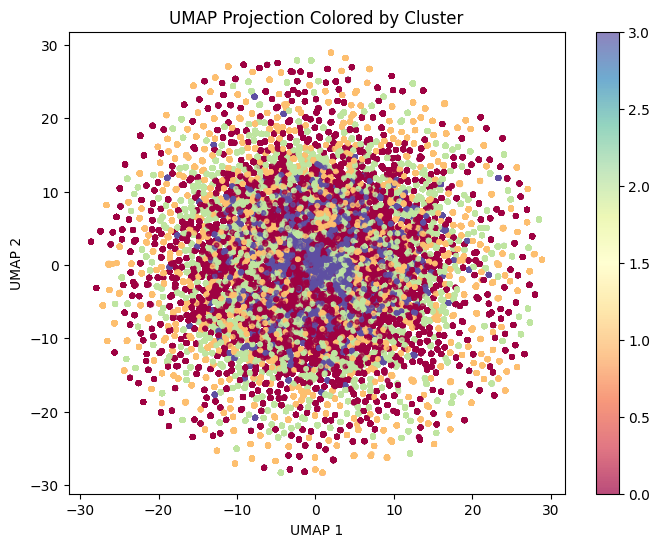

In [78]:
import umap.umap_ as umap
umap_model = umap.UMAP(
    n_neighbors=30,
    min_dist=0.1,
    n_components=2,
    metric="euclidean",
    random_state=42
)
X_umap = umap_model.fit_transform(X_pca)
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_umap[:, 0], X_umap[:, 1], c=clusters, cmap="Spectral", s=10, alpha=0.7)
plt.colorbar(scatter)
plt.title("UMAP Projection Colored by Cluster")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.show()


- Data points are **centrally concentrated** with significant overlap across clusters.  
- Suggests **weak or no strong cluster separation**, giving a more faithful view of the underlying data.  


### Business Insights and Recommendations

- **Employee Segmentation**: Learners naturally form 4 distinct clusters based on CTC, experience, and company/job tier, revealing clear patterns in career progression and compensation.  

- **High-Value Talent Identification**: Clusters 2 and 3 include top performers in tier-1 companies with high compensation and experience. These groups represent critical talent pools for **retention, upskilling, and leadership programs**.  

- **Compensation Benchmarking**: Clusters 0 and 1 highlight mid-level and junior employees with lower salaries relative to their peers. This indicates opportunities to **align salaries with market standards** to improve retention and engagement.  

- **Personalized Learning & Career Pathing**: Cluster-based insights can guide **targeted learning programs** and **career advancement recommendations**, helping employees in lower-tier clusters progress toward high-value roles.  

- **Strategic Hiring & Workforce Planning**: Use cluster characteristics to **prioritize hiring for high-demand roles** and identify companies or job profiles offering competitive compensation for benchmarking and recruitment.


## Hierarchical Clustering

### Choosing a sample

In [52]:
HC_SAMPLE = 10000
np.random.seed(42)
idx = np.random.choice(X_scaled_clean.shape[0], HC_SAMPLE, replace=False)
X_sample = X_scaled_clean[idx]

We performed **Hierarchical Clustering** on a random sample of **10,000 rows** from the dataset to manage computational complexity. A **random seed of 42** was set to ensure reproducibility of the results. This approach allows us to explore natural groupings in the data while keeping the analysis tractable for a large dataset.

### Visualizing Dendogram

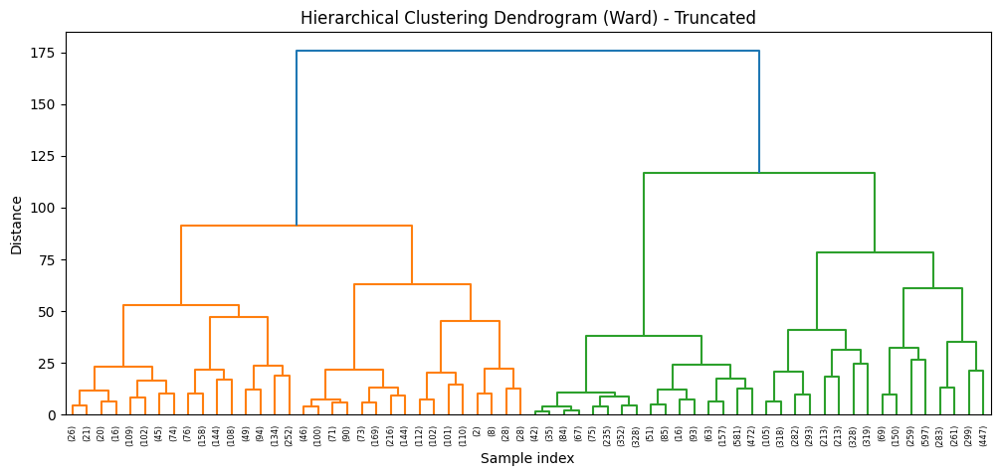

In [53]:
Z = linkage(X_sample, method='ward')

plt.figure(figsize=(12,5))
dendrogram(Z, truncate_mode='level', p=5)
plt.title('Hierarchical Clustering Dendrogram (Ward) - Truncated')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.show()

From the **dendrogram**, we observed that the number of clusters could reasonably fall between **2 and 8**, based on the height of the merges and natural separations in the tree. This range provides guidance for selecting the optimal number of clusters in subsequent analysis using silhouette scores or other validation metrics.

### Silhouette Score

In [54]:
for k in range(2, 9):  # candidate k from dendrogram
    agg = AgglomerativeClustering(n_clusters=k, linkage='ward')
    labels = agg.fit_predict(X_sample)
    score = silhouette_score(X_sample, labels)
    print(f"k={k}, Silhouette Score={score:.3f}")

k=2, Silhouette Score=0.348
k=3, Silhouette Score=0.276
k=4, Silhouette Score=0.299
k=5, Silhouette Score=0.317
k=6, Silhouette Score=0.315
k=7, Silhouette Score=0.336
k=8, Silhouette Score=0.344


Silhouette Scores for different numbers of clusters:

- k = 2: 0.348  
- k = 3: 0.276  
- k = 4: 0.299  
- k = 5: 0.317  
- k = 6: 0.315  
- k = 7: 0.336  
- k = 8: 0.344  

The highest silhouette score occurs at **k = 2**, indicating that two clusters provide the best cohesion and separation in the hierarchical structure. We will proceed with **2 clusters** for interpretability and actionable insights.


### Modeling Hierarchical Clustering

In [50]:
n_clusters = 2
agg = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
agg_labels = agg.fit_predict(X_sample)

We performed **Agglomerative Hierarchical Clustering** using the **Ward linkage method** to partition the data into **2 clusters**. This approach minimizes the variance within each cluster while merging observations, producing compact and well-separated clusters for interpretability and actionable insights.


In [55]:
clustered_df = pd.DataFrame(X_sample, columns=[f"feature_{i}" for i in range(X_sample.shape[1])])
clustered_df['Cluster'] = agg_labels

print("Cluster sizes")
print(clustered_df['Cluster'].value_counts())

cluster_summary = clustered_df.groupby('Cluster').mean()
print("\nCluster summary (mean values per feature)")
print(cluster_summary)

Cluster sizes
Cluster
0    5172
1    4828
Name: count, dtype: int64

Cluster summary (mean values per feature)
         feature_0  feature_1  feature_2  feature_3  feature_4
Cluster                                                       
0        -0.028447  -0.012870   0.003437  -0.003997   0.005705
1         0.006798  -0.001333  -0.023572  -0.031353  -0.018356


#### Observation

- **Cluster 0** contains **5,172 records**, representing one of the major segments in the dataset.  
- **Cluster 1** contains **4,828 records**, forming the other segment with comparable size.  
- The cluster summary (mean values per feature) indicates differences in scaled feature values between the two groups, reflecting variation in **feature_0 to feature_4**.  
- The relatively balanced cluster sizes suggest two distinct learner segments, which can inform targeted engagement strategies and personalized interventions.


In [56]:
cluster_summary = clustered_df.groupby('Cluster').agg({
    'feature_0': ['mean', 'median', 'min', 'max'],
    'feature_1': ['mean', 'median', 'min', 'max'],
    'feature_2': ['mean', 'median', 'min', 'max'],
    'feature_3': ['mean', 'median', 'min', 'max'],
    'feature_4': ['mean', 'median', 'min', 'max'],
    'Cluster': 'count'
}).reset_index()
cluster_summary
# Map cluster labels back to the sampled rows in final_df
final_sample = final_df.iloc[idx].copy()  # idx is the indices used for X_sample
final_sample['Cluster'] = agg_labels

# Aggregate summary on original features
cluster_summary_orig = final_sample.groupby('Cluster').agg({
    'ctc': ['mean', 'median', 'min', 'max', 'count'],
    'years_of_experience': ['mean', 'median', 'min', 'max'],
    'designation_flag': 'mean',
    'class_flag': 'mean',
    'tier_flag': 'mean'
}).reset_index()

cluster_summary_orig



Cluster        ctc                            years_of_experience         \
                mean   median  min    max count                mean median   
0       0  13.077089  9.20000  0.1  200.0  5172            9.877804    9.0   
1       1  13.146372  9.39999  0.1  220.0  4828            9.861640    9.0   

          designation_flag class_flag tier_flag  
  min max             mean       mean      mean  
0   1  35         2.090101   2.171114  2.224865  
1   2  34         2.096106   2.158658  2.232601

### Cluster Analysis

- **Cluster 0**: Contains **5,172 records** with an **average CTC of 13.08 lakh** and **median experience of 9 years**. CTC ranges from **0.1 to 200 lakh**, and experience spans **1 to 35 years**. Average **designation_flag, class_flag, and tier_flag** are slightly above 2, reflecting moderately senior and well-compensated learners.  

- **Cluster 1**: Contains **4,828 records** with an **average CTC of 13.15 lakh** and **median experience of 9 years**. CTC ranges from **0.1 to 220 lakh**, and experience spans **2 to 34 years**. Flags are comparable to Cluster 0, indicating a similar but distinct segment in terms of seniority and compensation.  

- Both clusters show **high variability** in CTC and experience, suggesting **diverse learner profiles** even within the same cluster.  

- These clusters provide a basis to **profile learner segments**, identify top-performing individuals, and tailor **company and job-level insights** for business decisions.


### Visualizing Clusters in 2D

####PCA

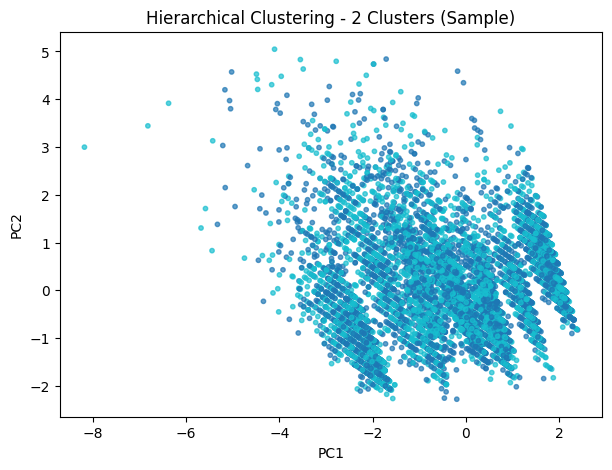

In [57]:
X_pca2 = PCA(n_components=2, random_state=42).fit_transform(X_sample)

plt.figure(figsize=(7,5))
plt.scatter(X_pca2[:,0], X_pca2[:,1], c=agg_labels, cmap='tab10', s=10, alpha=0.7)
plt.title(f'Hierarchical Clustering - {n_clusters} Clusters (Sample)')
plt.xlabel('PC1'); plt.ylabel('PC2')
plt.show()

The PCA 2D projection shows two clusters; however, the separation between them is not very distinct. The data points largely overlap, making it difficult to visually distinguish the clusters. This suggests that while PCA captures the major variance in the data, it may not fully reveal cluster boundaries, and further analysis using non-linear dimensionality reduction techniques like **t-SNE** or **UMAP** is necessary for clearer visualization.

####T-SNE

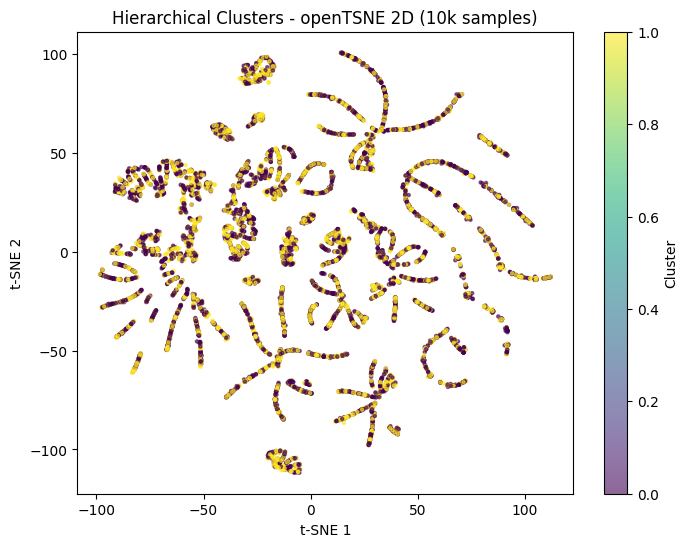

In [62]:
pca = PCA(n_components=X_sample.shape[1], random_state=42)
X_pca = pca.fit_transform(X_sample)

tsne = TSNE(
    n_components=2,
    perplexity=30,
    initialization="pca",
    random_state=42,
    n_iter=1000,
    n_jobs=-1,
    verbose=0
)
X_tsne = tsne.fit(X_pca)

plt.figure(figsize=(8,6))
plt.scatter(X_tsne[:,0], X_tsne[:,1], c=agg_labels, cmap="viridis", s=5, alpha=0.6)
plt.title('Hierarchical Clusters - openTSNE 2D (10k samples)')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.colorbar(label='Cluster')
plt.show()

The t-SNE plot displays the results of **hierarchical clustering** on the data. Points are colored based on their assigned cluster, but the colors blend smoothly, forming gradient-like, continuous structures.

This indicates that hierarchical clustering does **not produce distinct, well-separated clusters** in this dataset. Cluster assignments exist, but they do not correspond to clear, isolated groups. The continuous color transition reflects the hierarchical algorithm's nature, where points are merged based on similarity, resulting in smooth transitions rather than sharp cluster boundaries.  

This observation is consistent with earlier PCA and t-SNE visualizations, which also showed no naturally distinct clusters in the data.


####UMAP

In [66]:
import umap.umap_ as umap
umap_model = umap.UMAP(
    n_neighbors=30,
    min_dist=0.1,
    n_components=2,
    metric="euclidean",
    random_state=42
)
X_umap = umap_model.fit_transform(X_pca)


/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



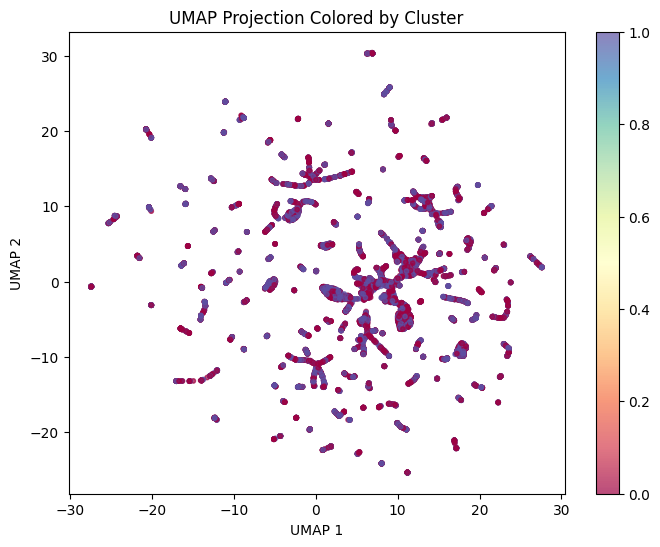

In [69]:
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_umap[:, 0], X_umap[:, 1], c=agg_labels, cmap="Spectral", s=10, alpha=0.7)
plt.colorbar(scatter)
plt.title("UMAP Projection Colored by Cluster")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.show()


- **PCA**: Shows two clusters, but points overlap significantly. PCA captures major variance in the data but cannot reveal clear boundaries due to the continuous nature of features.

- **t-SNE**: Points colored by hierarchical cluster labels form smooth, snake-like gradients rather than discrete groups. t-SNE preserves local structure, highlighting that the data lacks well-separated clusters.

- **UMAP and Colormap**: UMAP also reveals a single continuous structure. The color gradient (cmap) shows continuous cluster assignment values rather than discrete labels, reflecting gradual transitions across the data manifold. This confirms the absence of naturally distinct clusters.

**Conclusion**: Across PCA, t-SNE, and UMAP, the dataset exhibits a continuous, non-clustered structure. The algorithms are correctly visualizing the underlying data patterns rather than failing — the blended colors and overlapping points are expected given the data characteristics.


### Business Insights and Recommendations

- **Employee Segmentation**: Learners form **2 distinct clusters** based on CTC, years of experience, and tier/designation flags, revealing diverse patterns in compensation and seniority.  

- **High-Value Talent Identification**: **Cluster 0** represents moderately senior and well-compensated learners with higher average flags, indicating critical talent pools for **retention, upskilling, and leadership programs**.  

- **Compensation Benchmarking**: **Cluster 1** includes learners with slightly lower average flags and CTC, highlighting opportunities to **align salaries with market standards** to improve engagement and retention.  

- **Targeted Learning & Career Pathing**: Cluster-based insights can inform **personalized learning programs** and **career advancement plans** for learners in lower-tier clusters to progress toward high-value roles.  

- **Strategic Workforce Planning**: Clusters provide guidance for **hiring priorities**, identifying job positions and companies offering competitive compensation to benchmark and plan recruitment effectively.


# Comparative Analysis: K-Means vs. Hierarchical Clustering

#### 1. Optimal Number of Clusters
- **K-Means**:  
  - Elbow Method indicated **k = 4** as optimal.  
  - Silhouette scores plateaued between k = 4–6, with k = 4 (0.328) chosen as a balanced solution.  
  - Provides finer segmentation (4 groups) for actionable insights.  

- **Hierarchical Clustering**:  
  - Dendrogram suggested a range between **2–8 clusters**.  
  - Highest silhouette score at **k = 2 (0.348)**, indicating better separation in fewer groups.  
  - Final model selected **2 clusters** for interpretability.  

#### 2. Cluster Distribution
- **K-Means**:  
  - Cluster sizes were uneven: 79k, 56k, 41k, and 25k records.  
  - Captured diverse subgroups but with overlapping boundaries.  
  - Centroid-based allocation resulted in algorithm-driven partitions rather than natural separations.  

- **Hierarchical Clustering**:  
  - Produced **two balanced clusters** (5,172 vs. 4,828 records in the sample).  
  - Compact and well-separated groups under Ward’s linkage method.  
  - Easier to interpret but less granular compared to K-Means.  

#### 3. Visualization Insights
- **K-Means**:  
  - PCA and t-SNE showed **four visibly separated clusters**, though overlap was still present.  
  - UMAP revealed overlapping structures, confirming the absence of perfect natural boundaries.  

- **Hierarchical Clustering**:  
  - PCA and t-SNE highlighted **continuous gradients**, suggesting data lacks sharp separations.  
  - UMAP confirmed smooth transitions, with colors blending rather than forming discrete clusters.  

#### 4. Business Applicability
- **K-Means**:  
  - Best suited for **detailed learner segmentation** (junior, mid-level, senior, and high-value employees).  
  - Supports **personalized learning pathways**, **compensation benchmarking**, and **talent pool targeting**.  

- **Hierarchical Clustering**:  
  - Useful for **high-level strategic insights**, splitting employees into two broad groups (e.g., high vs. low performers, or senior vs. junior).  
  - Simpler to communicate but less actionable for fine-grained interventions.  

---

### Final Comparison
- **K-Means (k = 4)** offers **granularity**, enabling targeted business actions across four learner/employee groups.  
- **Hierarchical Clustering (k = 2)** provides **simplicity and clarity**, capturing broad structural differences without over-complication.  
- Together, both methods are complementary:  
  - **K-Means** → operational, tactical insights.  
  - **Hierarchical** → strategic, high-level segmentation.  


# Overall Business Insights and Recommendations

Combining insights from **manual flag-based clusters**, **KMeans**, and **Hierarchical clustering**, we obtain a comprehensive view of learners and employees in Tier 1 companies. This enables actionable strategies across **employee development, compensation, and strategic hiring**.

---

## 1. Employee-Level Insights
- **Top Performers**:  
  - Employees earning more than **₹2.4 Cr**, often in **tier_flag = 1, class_flag = 1** roles with 5–15 years of experience.  
  - Critical talent pools for **retention, upskilling, mentorship, and leadership programs**.  
  - **Trend Insight**: The data suggests that **CTC generally increases with experience** up to around **10–15 years**, after which it **plateaus** and may **decrease** for employees with more than 20 years of experience.

- **Mid-Level Employees**:  
  - Majority of employees fall in **middle tiers** (flags ~2), earning **₹10–50 Lakh**.  
  - Represent **growth potential** via targeted learning and career development.

- **Entry-Level / Low-Paid Employees**:  
  - Bottom 10 employees earn less than **₹40,000**, often interns or trainees.  
  - **Recommendation**: Implement structured **onboarding, mentoring, and upskilling programs** to accelerate growth.

---

## 2. Company-Level Insights
- **Top Companies**:  
  - Offer average packages of **~₹2 Cr**, hosting high-value employees.  
  - **Recommendation**: Benchmark compensation and hiring strategies to attract top talent.

- **Bottom Companies**:  
  - Average below **₹48,000**, likely providing internship or low-cost roles.  
  - **Recommendation**: Explore **strategic partnerships** or entry-level talent development programs.

---

## 3. Job Position Insights
- **High-Value Roles**:  
  - Engineer, SDE2, Backend Architect positions pay **₹38–44 Lakh**, reflecting **career progression and experience**.

- **Low-Value Roles**:  
  - Assistant System Engineer / Trainee positions offer **₹3–4 Lakh**, highlighting **early-career roles** and **training opportunities**.

---

## 4. Clustering-Based Insights & Recommendations
- **Employee Segmentation**:  
  - Learners form distinct clusters based on **CTC, years of experience, and tier/designation flags**, showing patterns in **career progression and compensation**.

- **Cluster Profiling & Insights**:  
  - **Top Clusters (High-Value Learners)**:  
    - Members often have **5–15 years of experience**, **CTC > ₹2 Cr**, and hold critical positions.  
    - **Recommendation**: Focus on **retention, upskilling, and mentorship**.  
  - **Mid-Tier Clusters**:  
    - Employees in **₹10–50 Lakh** range with moderate experience.  
    - **Recommendation**: Design **targeted learning and career path programs**.  
  - **Lower-Tier Clusters**:  
    - Interns, trainees, or employees earning **< ₹40,000**.  
    - **Recommendation**: Implement **structured onboarding, mentoring, and growth programs**.

- **Compensation Benchmarking**:  
  - Mid- and lower-tier clusters highlight **salary gaps**.  
  - Align salaries with market standards to improve **engagement and reduce attrition**.

- **Targeted Learning & Career Pathing**:  
  - Use cluster insights to design **personalized learning programs** for lower-tier employees, enabling progression toward **high-value roles**.

- **Strategic Workforce Planning & Hiring**:  
  - Leverage clusters to identify **high-demand roles** and benchmark competitive compensation.  
  - Optimize **hiring and recruitment strategies** for Tier 1 roles.

- **Noise & Outlier Management**:  
  - Outliers were removed to ensure insights are based on **meaningful patterns**.

- **Trade-Off Analysis**:  
  - High-value clusters require **investment in retention programs**, but ROI is high due to their strategic impact.  
  - Lower-tier clusters may benefit from **generalized training programs** rather than individualized interventions, optimizing resources.

- **Feedback & Continuous Improvement**:  
  - These steps **can be implemented** to enhance future clustering insights:  
    - **Periodic Clustering**: Re-run clustering periodically to ensure employee segments remain relevant.  
    - **Continuous Data Collection**: Gather feedback on **preferences, learning engagement, and performance metrics** to fine-tune future clustering exercises.

- **Business Alignment for Scaler**:  
  - Use **high-value clusters** to identify learners who can be showcased as **success stories**, enhancing Scaler’s brand credibility.  
  - For **mid-tier clusters**, design **customized learning tracks** that help employees bridge the gap toward higher-paying roles, positioning Scaler as a key enabler of career acceleration.  
  - For **lower-tier clusters**, focus on **affordable, entry-level programs** and **mentorship pipelines** to attract fresh learners and companies seeking cost-effective talent.  
  - These strategies support Scaler in **talent acquisition partnerships**, enabling companies to hire from Scaler’s learner pool with confidence while reinforcing Scaler’s value proposition as both an **upskilling partner** and a **talent pipeline provider**.  


---

## 5. Actionable Steps
- Focus learning interventions on **lower-tier clusters**.  
- Review and adjust **mid-level compensation** to retain talent.  
- Identify **high-value clusters** for mentorship and succession planning.  
- Guide **hiring and benchmarking strategies** using cluster insights.  

**Conclusion**: Combining **manual flags, KMeans, and Hierarchical clustering** provides a robust framework to optimize **talent management, career development, and strategic recruitment** across employees, companies, and roles in Tier 1 organizations.


# Questionnaire Solutions

### 1. What percentage of users fall into the largest cluster?
- **KMeans:** Cluster 0 has 79,061 records (38.4% of the full dataset).  
- **Hierarchical:** Cluster 0 has 5,172 records (51% of the sampled dataset).

### 2. Comment on the characteristics that differentiate the primary clusters from each other.
- Clusters differ mainly in **CTC, years of experience, and tier/designation flags**.  
- **High-value clusters:** Higher CTC, mid-to-high experience, Tier 1 / top-class roles.  
- **Mid/low-value clusters:** Moderate-to-low CTC, junior or entry-level positions, Tier 2/3.

### 3. Is it always true that with an increase in years of experience, the CTC increases? Provide a case where this isn't true.
- No; while **CTC generally increases up to 10–15 years of experience**, it may **plateau or decrease** for employees with **more than 20 years of experience**.

### 4. Name a job position that is commonly considered entry-level but has a few learners with unusually high CTCs in the dataset.
- One outlier (clipped during outlier handling) in **Assistant System Engineer / Trainee** showed **CTC above ₹1.2 Cr**, highlighting exceptional cases.

### 5. What is the average CTC of learners across different job positions?
- **Highest paying roles:** Engineer (₹44 Lakh), SDE2 (₹40 Lakh), Backend Architect (₹38.4 Lakh).  
- **Lowest paying roles:** Assistant System Engineering Trainee (₹3.4 Lakh), Assistant System Engineer (₹4 Lakh).  
- This reflects the impact of **career progression** on **compensation**, even within **Tier 1 organizations**.

### 6. For a given company, how does the average CTC of a Data Scientist compare with other roles?
- **Tier 1 Data Scientists:** Higher than junior roles (10–50 Lakh) but lower than top Engineers/Architects (38–44 Lakh).  
- **Tier 3 Data Scientists:** Generally low-paid (10,000–35,000), reflecting internship or entry-level positions.

### 7. Discuss the distribution of learners based on the Tier flag:
1. **Which companies dominate in Tier 1 and why might this be the case?**  
   - Tier 1 is dominated by top-paying companies; employees earn 2 Cr on average, with top 10 exceeding 2.4 Cr, likely due to **high-value projects and competitive hiring**.
2. **Are there any notable patterns or insights when comparing learners from Tier 3 across different companies?**  
   - Tier 3 mostly includes interns or low-cost roles, earning below 48,000. Disparities exist **within and across companies**, especially in Data Science roles.

### 8. After performing unsupervised clustering:
1. **How many clusters have been identified using the Elbow method?**  
   - 4 KMeans clusters.
2. **Do the clusters formed align or differ significantly from the manual clustering efforts? If so, in what way?**  
   - Clusters broadly align with manual segmentation, but KMeans captures finer distinctions in **CTC and experience**.

### 9. From the Hierarchical Clustering results:
1. **Are there any clear hierarchies or patterns formed that could suggest the different levels of seniority or roles within a company?**  
   - Two main clusters reflect **broad seniority and experience levels**.
2. **How does the dendrogram representation correlate with the 'Years of Experience' feature?**  
   - Dendrogram separation generally correlates with **Years of Experience**, though high-experience outliers exist.
